# Homework Assignment 8

**Question 1:** Select a book or a movie's subtitle, and find the locations that appear in the book/movie. Then, draw these locations on a map (at least 10 locations) (30pt). Connect the discovered locations with lines according to their order of appearance
in the book. For example, if location B appeared immediately after location A, then draw a line connecting locations A and B (20pt).

In [ ]:
!pip install geopandas
!pip install turicreate
!pip install spaCy
!python -m spacy download en_core_web_lg
!pip install plotly_express
!pip install folium

     |████████████████████████████████| 1.0 MB 5.3 MB/s 
     |████████████████████████████████| 15.4 MB 44.9 MB/s 
     |████████████████████████████████| 6.3 MB 46.6 MB/s 
     |████████████████████████████████| 92.0 MB 22 kB/s 
     |████████████████████████████████| 322 kB 33.5 MB/s 
     |████████████████████████████████| 3.5 MB 46.7 MB/s 
     |████████████████████████████████| 86.4 MB 66 kB/s 
     |████████████████████████████████| 3.6 MB 32.3 MB/s 
     |████████████████████████████████| 18.3 MB 464 kB/s 
     |████████████████████████████████| 2.9 MB 43.0 MB/s 
     |████████████████████████████████| 50 kB 5.8 MB/s 
     |████████████████████████████████| 449 kB 54.3 MB/s 
     |████████████████████████████████| 3.8 MB 56.4 MB/s 
     |████████████████████████████████| 20.1 MB 1.2 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=bcf5e2aef280dbc745a335e398600e02b977a86088c284871f5edbd158bbba83
  Stored in directory: /root/.ca

     |████████████████████████████████| 827.9 MB 1.3 MB/s 
  Created wheel for en-core-web-lg: filename=en_core_web_lg-2.2.5-py3-none-any.whl size=829180942 sha256=ab900411ea1cee5f8f068cf37be541d2e86b6d24c5ea488fe7c193ca31bb8f3c
  Stored in directory: /tmp/pip-ephem-wheel-cache-1do91ek6/wheels/11/95/ba/2c36cc368c0bd339b44a791c2c1881a1fb714b78c29a4cb8f5
Successfully built en-core-web-lg
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_lg')


In [ ]:
import json
!mkdir /root/.kaggle/
# Installing the Kaggle package
!pip install kaggle 


#!!!fill your api key!!!
api_token = {"username":"","key":""}

with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

# Creating a dataset directory
!mkdir ./datasets
!mkdir ./datasets/dickens

# download the dataset from Kaggle and unzip it
!kaggle datasets download fuzzyfroghunter/dickens -p ./datasets/
!unzip ./datasets/dickens.zip  -d ./datasets/

mkdir: cannot create directory ‘/root/.kaggle/’: File exists
mkdir: cannot create directory ‘./datasets’: File exists
mkdir: cannot create directory ‘./datasets/dickens’: File exists
dickens.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  ./datasets/dickens.zip
replace ./datasets/dickens/1289-0.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: ./datasets/dickens/1289-0.txt  
  inflating: ./datasets/dickens/1400-0.txt  
  inflating: ./datasets/dickens/1467-0.txt  
  inflating: ./datasets/dickens/27924-0.txt  
  inflating: ./datasets/dickens/564-0.txt  
  inflating: ./datasets/dickens/580-0.txt  
  inflating: ./datasets/dickens/644-0.txt  
  inflating: ./datasets/dickens/650-0.txt  
  inflating: ./datasets/dickens/653-0.txt  
  inflating: ./datasets/dickens/675-0.txt  
  inflating: ./datasets/dickens/678-0.txt  
  inflating: ./datasets/dickens/700-0.txt  
  inflating: ./datasets/dickens/766-0.txt  
  inflating: ./datasets/dickens/7

In [ ]:
import spacy
from tqdm import tqdm
from collections import Counter
import networkx as nx

nlp = spacy.load('en_core_web_lg')

txt = open("./datasets/dickens/27924-0.txt").read()
# paragraphs_list = txt.split("\n\n")

def get_loc_pos(txt):

    doc = nlp(txt)
    locations = [{"name":entity.text.lower().strip(), "position":entity.start_char} for entity in doc.ents if entity.label_ in ["GPE"]]

    locations_positions= {}              
    for location in locations:
      if len(location)< 2:
        continue
      if location["name"] not in locations_positions:
        locations_positions[location["name"]] = [location["position"]]
      locations_positions[location["name"]].append(location["position"])

    #Keeping only the position of the first apperence    
    locations_positions = {location_name: min(location_positions) for location_name, location_positions in locations_positions.items()}

    return locations_positions

loc_pos = get_loc_pos(txt)

In [ ]:
loc_pos

{'ak': 290332,
 'alexandria': 218906,
 'america': 74644,
 'amiens': 106243,
 'ariz': 103393,
 'auvergne': 173116,
 'barbox': 83795,
 'belgium': 240135,
 'birmingham': 238826,
 'bombay': 263218,
 'brighton': 145126,
 'britain': 96092,
 'britannia': 93218,
 'cairo': 263000,
 'camden': 205783,
 'canada': 220584,
 'chadleigh': 236043,
 'civita vecchia': 169617,
 'clifton': 195751,
 'constantinople': 262785,
 'eaton': 213713,
 'england': 24954,
 'europian village': 94944,
 'euston': 207095,
 'fairbanks': 290321,
 'france': 94869,
 'genoa': 240039,
 'genoa railway\ncompany': 242117,
 'germany': 240144,
 'holland': 240126,
 'huntingdon': 212361,
 'india': 263325,
 'inn': 29450,
 'italy': 94880,
 'kent': 83582,
 'leeds': 138890,
 'liverpool': 138981,
 'london': 1570,
 'loredano': 268098,
 'malta': 234413,
 'manchester': 138995,
 'mantua': 265334,
 'marseilles': 96400,
 'midland': 193345,
 'mississippi': 289945,
 'molo': 251517,
 'morocco': 197569,
 'naples': 253524,
 'nimroud': 263082,
 'padde

In [ ]:
def get_loc_counts(txt):
    doc = nlp(txt)
    locations = [entity.text.lower().strip() for entity in doc.ents if entity.label_ == "GPE"]
    location_counts = {key: value for key,value in dict(Counter(locations)).items()}
    return location_counts
loc_counts = get_loc_counts(txt)

In [ ]:
loc_appearance_order = [loc[0] for loc in sorted(loc_pos.items(), key=lambda item: item[1]) if loc_counts[loc[0]]>2]
links = list(zip(loc_appearance_order,loc_appearance_order[1:]))
loc_counts = {key: value for key,value in loc_counts.items() if value>2}

links

[('london', 'england'),
 ('england', 'phœbe'),
 ('phœbe', 'wales'),
 ('wales', 'france'),
 ('france', 'italy'),
 ('italy', 'marseilles'),
 ('marseilles', 'paris'),
 ('paris', 'morocco'),
 ('morocco', 'camden'),
 ('camden', 'alexandria'),
 ('alexandria', 'birmingham'),
 ('birmingham', 'turin'),
 ('turin', 'genoa'),
 ('genoa', 'mantua'),
 ('mantua', 'venice'),
 ('venice', 'loredano'),
 ('loredano', 'the united states'),
 ('the united states', 'u.s.')]

In [ ]:
from functools import lru_cache
import time
from geopy.geocoders import Nominatim

geolocator = Nominatim(user_agent="Data Science Education App") #  Using OpenStreetMap Nominatim

@lru_cache(maxsize=256)
def get_location(loc):
    time.sleep(1)
    return geolocator.geocode(loc)

# fig, ax = plt.subplots(figsize=(30,30))
# cities.plot(ax=ax, color='lightgreen', edgecolor='gray')
def loc_coordinates(locations_names):
  locations_coordinates = {}
  for location_name in locations_names:
    location = get_location(location_name)
    locations_coordinates[location_name]={}
    locations_coordinates[location_name]["longitude"] = location.longitude  
    locations_coordinates[location_name]["latitude"] = location.latitude  
  return locations_coordinates

loc_cords = loc_coordinates(loc_counts.keys())

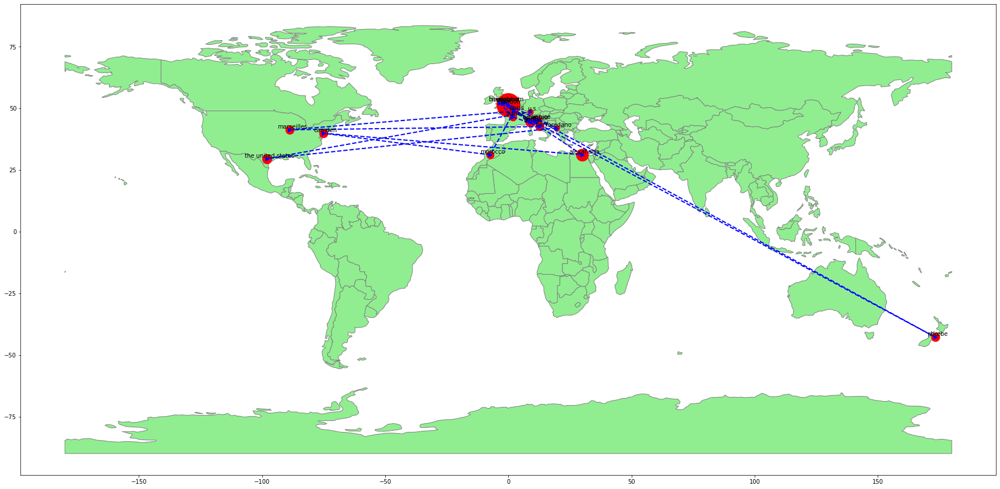

In [ ]:
from scipy.interpolate import interp1d # for transfaering font size
import matplotlib.pyplot as plt
%matplotlib inline
import geopandas

m = interp1d([2,max(loc_counts.values())],[8,40])
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
ax = world.plot(color='lightgreen', edgecolor='gray',figsize=(30,30))
for loc, v in loc_counts.items():
    # print(f"{location} : location.longitude: {location.longitude}, v: {v}")
    plt.plot(loc_cords[loc]["longitude"],loc_cords[loc]["latitude"], marker='o', color='red', markersize=m(v))
    plt.annotate(s=loc, xy=(loc_cords[loc]["longitude"]+1,loc_cords[loc]["latitude"]+0.5),
                 horizontalalignment='center', fontsize=10,color="black")
for link_src, link_dest in links:
  plt.plot([loc_cords[link_src]["longitude"], loc_cords[link_dest]["longitude"]], [loc_cords[link_src]["latitude"], loc_cords[link_dest]["latitude"]],
         color='blue', linewidth=2, linestyle='--',marker=">")


**Question 2:** Select a country's' statistic from the [World Development Indicators dataset](https://www.kaggle.com/worldbank/world-development-indicators) (Please notice there are several files in the dataset, such as _Indicators.csv_).
Then, create a choropleth map displaying how the selected statistics changed over time (15pt) 
    
**Bonus:** Create a short animation that displays how the chosen statistics changed over time (15pt)

In [ ]:
!mkdir ./datasets/dickens/dev_indicator

!kaggle datasets download manchunhui/world-development-indicators -f WDIData_T.csv -p ./datasets/dev_indicator
!unzip ./datasets/dev_indicator/WDIData_T.csv.zip  -d ./datasets/dev_indicator

 90% 149M/165M [00:00<00:00, 152MB/s]
100% 165M/165M [00:01<00:00, 154MB/s]
Archive:  ./datasets/dev_indicator/WDIData_T.csv.zip
  inflating: ./datasets/dev_indicator/WDIData_T.csv  


In [ ]:
import turicreate as tc
sf = tc.SFrame.read_csv("./datasets/dev_indicator/WDIData_T.csv")
country = "Israel"
country_code = "ISR"
indicator = "CO2 emissions (metric tons per capita)"

sf = sf[sf["CountryName"] == country]
sf = sf[sf["IndicatorName"] == indicator]
sf.materialize()
sf = sf["CountryCode","Year", "Value"]
sf

Finished parsing file /content/datasets/dev_indicator/WDIData_T.csv

Parsing completed. Parsed 100 lines in 2.33415 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,int,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 503984 lines. Lines per second: 244665

Read 3006852 lines. Lines per second: 412035

Read 5447161 lines. Lines per second: 430487

Finished parsing file /content/datasets/dev_indicator/WDIData_T.csv

Parsing completed. Parsed 7578806 lines in 16.6525 secs.

CountryCode,Year,Value
ISR,1960,3.05985184624554
ISR,1961,3.23568695652174
ISR,1962,3.46389969472307
ISR,1963,3.4512034468264003
ISR,1964,3.69663232323232
ISR,1965,5.050530628170111
ISR,1966,5.1720182578927405
ISR,1967,4.9334174863388
ISR,1968,4.92683624687834
ISR,1969,5.150624608967671


In [ ]:
import plotly_express as px
fig = px.choropleth(sf.to_dataframe(), locations='CountryCode', color='Value', animation_frame='Year', projection="natural earth", range_color=[min(sf["Value"]),max(sf["Value"])] )
fig.update_geos(lataxis_range=[25,35], lonaxis_range=[30, 40])

**Question 3:** Select a request type from [San Francisco 311 dataset](https://www.kaggle.com/datasf/case-data-from-san-francisco-311).
Create an interactive map that somehow presents in which areas this request occurs the most (35pt).

In [ ]:
!mkdir ./datasets/dickens/sf331

!kaggle datasets download datasf/case-data-from-san-francisco-311 -f Case_Data_from_San_Francisco_311__SF311.csv -p ./datasets/sf331
!unzip ./datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv.zip  -d ./datasets/sf331

 96% 116M/121M [00:00<00:00, 111MB/s]
100% 121M/121M [00:00<00:00, 138MB/s]
Archive:  ./datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv.zip
  inflating: ./datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv  


In [ ]:
r_coordinates = re.compile(r"\(-?([0-9]*[.])?[0-9]+, -?([0-9]*[.])?[0-9]+\)") 

print(r_coordinates.search(sf["Point"][0]))
sf["Point"][0]

<re.Match object; span=(0, 37), match='(37.7571008516766, -122.417811874214)'>


'(37.7571008516766, -122.417811874214)'

In [ ]:
import ast
import turicreate as tc
import re

sf = tc.SFrame.read_csv("./datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv", nrows=2000000)
sf.materialize()

r_coordinates = re.compile(r"\(-?([0-9]*[.])?[0-9]+, -?([0-9]*[.])?[0-9]+\)") 

sf["latitude"] = sf["Point"].apply(lambda x: ast.literal_eval(x)[0] if r_coordinates.search(x) is not None else None)
sf["longitude"] = sf["Point"].apply(lambda x: ast.literal_eval(x)[1] if r_coordinates.search(x) is not None else None)
sf = sf["Point","latitude","longitude"]
sf = sf.dropna()
sf.materialize()
sf

Finished parsing file /content/datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv

Parsing completed. Parsed 100 lines in 2.45955 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,str,str,str,str,str,str,str,int,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 189228 lines. Lines per second: 88161.3

Unexpected characters after last column. "Abandoned Vehicle - Car4door"
Parse failed at token ending at: 
	s Work Queue,Abandoned Vehicle,Abandoned Vehicle - Car4door,^Gray - Volkswagen -  - 7MJV079,Intersection of 2
Successfully parsed 16 tokens: 
	0: 5526685
	1: 02/02/2016 ... 5:55:47 AM
	2: 02/03/2016 ... 1:21:40 AM
	3: 02/03/2016 ... 1:21:40 AM
	4: Closed
	5: "Case Reso ... 1256715196
	6: -122.391840449142)"
	7: Voice In
	8: 5698025
	9: 03/24/2016 ... 8:34:48 PM
	10: 03/29/2016 ... 8:25:01 AM
	11: 3
	12: Closed
	13: DPT Abando ...       #229
	14: DPT Abando ... Work Queue
	15: Abandoned Vehicle

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,General Requests,
Successfully parsed 0 tokens:

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,Noise Report,mech
Successfully parsed 0 tokens:

Unexpected characters after last column. "DPW Ops Queue"
Parse failed at token ending at: 
	:00:36 AM,Closed,Case Resolved - duplicate sr,DPW Ops Queue,^Street and Sidewalk Cleaning,Illegal Encampment,
Successfully parsed 16 tokens: 
	0: 415
	1: DPH - Envi ... Health - G
	2: Street and ... k Cleaning
	3: Hazardous Materials
	4: Needles
	5: Intersecti ... and 8TH ST
	6: 10
	7: Showplace Square
	8: (37.767300 ... 428647996)
	9: Voice In
	10: 5698219
	11: 3
	12: 03/25/2016 ... 7:00:36 AM
	13: 03/25/2016 ... 7:00:36 AM
	14: Closed
	15: Case Resol ... plicate sr

Unexpected characters after last column. "DPW Ops Queue"
Parse failed at token ending at: 
	/2016 01:00:00 AM,Closed,Case Resolved - done,DPW Ops Queue,^Street and Sidewalk Cleaning,Hazardous Materials
Successfully parsed 16 tokens: 
	0: 415
	1: DPH - Envi ... Health - G
	2: Street and ... k Cleaning
	3: Hazardous Materials
	4: Needles
	5: Intersecti ...  HOWARD ST
	6: 6
	7: South of Market
	8: (37.773100 ... 561380814)
	9: Voice In
	10: 5698609
	11: 3
	12: 03/29/2016 ... 1:00:00 AM
	13: 03/29/2016 ... 1:00:00 AM
	14: Closed
	15: Case Resolved - done

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Unable to interpret "(415)-252-380"" as a integer
Parse failed at token ending at: 
	 (415)-252-380",^DPH - Environmental Health - G,Noise Report,garb
Successfully parsed 0 tokens:

Unable to interpret "Environmental Health-DPH" as a integer
Parse failed at token ending at: 
	 Environmental Health-DPH^
Successfully parsed 0 tokens:

Read 1043264 lines. Lines per second: 132106

16596 lines failed to parse correctly

Finished parsing file /content/datasets/sf331/Case_Data_from_San_Francisco_311__SF311.csv

Parsing completed. Parsed 1161482 lines in 9.78531 secs.

Point,latitude,longitude
"(37.7571008516766,-122.417811874214) ...",37.7571008516766,-122.417811874214
"(37.7884895281133,-122.421948485141) ...",37.7884895281133,-122.421948485141
"(37.7850837365507,-122.447620029034) ...",37.7850837365507,-122.447620029034
"(37.795328529,-122.418067787) ...",37.795328529,-122.418067787
"(37.772204762,-122.4487004) ...",37.772204762,-122.4487004
"(37.79140462,-122.410247421) ...",37.79140462,-122.410247421
"(37.7832142923006,-122.410764953722) ...",37.7832142923006,-122.410764953722
"(37.791643509125,-122.419260423291) ...",37.791643509125,-122.419260423291
"(37.765800070469,-122.449958075232) ...",37.765800070469,-122.449958075232
"(37.7509362479361,-122.413364630104) ...",37.7509362479361,-122.413364630104


In [ ]:
import folium
from folium.plugins import HeatMap

tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

data = [(r['latitude'],r['longitude']) for r in sf[:500000]]
HeatMap(data, radius = 5).add_to(m)
# display(m)
m